In [1]:
import sympy
from sympy import symbols, Matrix, Function, sin, cos, zeros, eye, simplify, lambdify, diag, Eq, solve, pi
from tqdm.notebook import tqdm


import numpy as np

In [2]:
## Helper Functions 

## vector to se3
def unhat6(hatted):
    vec = Matrix([hatted[0,3], hatted[1,3], hatted[2,3], hatted[2,1], hatted[0,2], hatted[1,0]])
    return vec

## se3 from vector
def hat6(unhatted):
    hat = zeros(4,4)
    v1 = unhatted[0, 0]
    v2 = unhatted[1, 0]
    v3 = unhatted[2, 0]
    w1 = unhatted[3,0]
    w2 = unhatted[4,0]
    w3 = hatted[5,0]    
    mat = Matrix([[0, -w3, w2, v1],[w3, 0, -w1, v2],[-w2, w1, 0, v3],[0, 0, 0, 0]])
    return mat

## Un-homogenizing a vector
def unbar4(barred):
    vec = barred[:3]
    return vec

## inverse of SE3 transform
def SE3Inv(g):
    inv = zeros(4,4)
    inv[:3, :3] = g[:3,:3].T
    inv[:3, 3] = -g[:3,:3].T * g[:3, 3]
    inv[3, :] = g[3,:]
    return inv

## time derivative of SE3 transform
def SE3dt(SE3, t):
    return SE3.diff(t)

In [3]:
## system parameters
l_dice, l_cup, t, g, th_cup = symbols("l_dice, l_cup, t, g, th_cup")
m_dice, m_cup = symbols("m_dice, m_cup")

## system variables, dummy
x_d, y_d, theta_d, x_c, y_c, theta_c = symbols("x_dice, y_dice, theta_dice, x_cup, y_cup, theta_cup")
q_dummy = Matrix([x_d, y_d, theta_d, x_c, y_c, theta_c])

## Transforms for the Body frames in the inertial frame
gWC = Matrix([[cos(theta_c), -sin(theta_c), 0, x_c],[sin(theta_c), cos(theta_c), 0, y_c],[0, 0, 1, 0],[0,0,0,1]])
gWD = Matrix([[cos(theta_d), -sin(theta_d), 0, x_d],[sin(theta_d), cos(theta_d), 0, y_d],[0, 0, 1, 0],[0,0,0,1]])

## For the dice in the cup fram
gCW = SE3Inv(gWC)
gCD = gCW * gWD

## bottom  right corner of the dice in its body frame
r4_d = Matrix([l_dice/2, -l_dice/2, 0, 1])
## top right corner of the dice in its body frame
r1_d = Matrix([l_dice/2, l_dice/2, 0, 1])
## top left corner of the dice in its body frame
r2_d = Matrix([-l_dice/2, l_dice/2, 0, 1])
## bottom left corner of the dice in its body frame
r3_d = Matrix([-l_dice/2, -l_dice/2, 0, 1])

## in body frame of the cup
r4_c = gCD * r4_d

## remaining corners in body frame of cup
r1_c = gCD * r1_d
r2_c = gCD * r2_d
r3_c = gCD * r3_d

## phi for bottom right corner of dice with the bottom wall of cup, Wb  --- ALL IN THE CUP BODY FRAME
phi4Wb = r4_c[1] + l_cup/2 #bottom wall


## remaining phis for biottom right corner of dice, r4
phi4Wt = r4_c[1] - l_cup/2  #top wall
phi4Wl = r4_c[0] + l_cup/2  #left wall
phi4Wr = r4_c[0] - l_cup/2  #right wall

## phis for r1 with bottom, top, left, right walls in the Cup body frame
phi1Wb = r1_c[1] + l_cup/2 #bottom wall
phi1Wt = r1_c[1] - l_cup/2  #top wall
phi1Wl = r1_c[0] + l_cup/2  #left wall
phi1Wr = r1_c[0] - l_cup/2  #right wall

## phis for r2 with bottom, top, left, right walls in the Cup body frame
phi2Wb = r2_c[1] + l_cup/2 #bottom wall
phi2Wt = r2_c[1] - l_cup/2  #top wall
phi2Wl = r2_c[0] + l_cup/2  #left wall
phi2Wr = r2_c[0] - l_cup/2  #right wall

## phis for r3 with bottom, top, left, right walls in the Cup body frame
phi3Wb = r3_c[1] + l_cup/2 #bottom wall
phi3Wt = r3_c[1] - l_cup/2  #top wall
phi3Wl = r3_c[0] + l_cup/2  #left wall
phi3Wr = r3_c[0] - l_cup/2  #right wall

## subbing in values for parameters and testing for impact
subs1 = {l_dice:0.5, l_cup:4, g:9.8, m_cup: 10, m_dice:1, th_cup:0.5}
phi4Wb = phi4Wb.subs(subs1)

## subbing into the rest of the impact conditions
phi4Wt = phi4Wt.subs(subs1)
phi4Wl = phi4Wl.subs(subs1)
phi4Wr = phi4Wr.subs(subs1)
phi1Wb = phi1Wb.subs(subs1) 
phi1Wt = phi1Wt.subs(subs1)
phi1Wl = phi1Wl.subs(subs1)
phi1Wr = phi1Wr.subs(subs1)
phi2Wb = phi2Wb.subs(subs1)
phi2Wt = phi2Wt.subs(subs1)
phi2Wl = phi2Wl.subs(subs1)
phi2Wr = phi2Wr.subs(subs1)
phi3Wb = phi3Wb.subs(subs1)
phi3Wt = phi3Wt.subs(subs1)
phi3Wl = phi3Wl.subs(subs1)
phi3Wr = phi3Wr.subs(subs1)

## gradphis for each phi
grad_phi4Wb = phi4Wb.diff(q_dummy)
grad_phi4Wt = phi4Wt.diff(q_dummy)
grad_phi4Wl = phi4Wl.diff(q_dummy)
grad_phi4Wr = phi4Wr.diff(q_dummy)
grad_phi1Wb = phi1Wb.diff(q_dummy)
grad_phi1Wt = phi1Wt.diff(q_dummy)
grad_phi1Wl = phi1Wl.diff(q_dummy)
grad_phi1Wr = phi1Wr.diff(q_dummy)
grad_phi2Wb = phi2Wb.diff(q_dummy)
grad_phi2Wt = phi2Wt.diff(q_dummy)
grad_phi2Wl = phi2Wl.diff(q_dummy)
grad_phi2Wr = phi2Wr.diff(q_dummy)
grad_phi3Wb = phi3Wb.diff(q_dummy)
grad_phi3Wt = phi3Wt.diff(q_dummy)
grad_phi3Wl = phi3Wl.diff(q_dummy)
grad_phi3Wr = phi3Wr.diff(q_dummy)


## lambdifying 
phi4Wb_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi4Wb)
phi4Wt_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi4Wt)
phi4Wl_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi4Wl)
phi4Wr_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi4Wr)

phi1Wb_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi1Wb)
phi1Wt_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi1Wt)
phi1Wl_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi1Wl)
phi1Wr_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi1Wr)

phi2Wb_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi2Wb)
phi2Wt_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi2Wt)
phi2Wl_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi2Wl)
phi2Wr_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi2Wr)

phi3Wb_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi3Wb)
phi3Wt_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi3Wt)
phi3Wl_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi3Wl)
phi3Wr_f = lambdify([x_d, y_d, theta_d, x_c, y_c, theta_c], phi3Wr)


## Setting up lambdas 
lam1, lam2, lam3, lam4 = symbols("lambda1, lambda2, lambda3, lambda4")
lam5, lam6, lam7, lam8 = symbols("lambda5, lambda6, lambda7, lambda8")
lam9, lam10, lam11, lam12 = symbols("lambda19, lambda10, lambda11, lambda12")
lam13, lam14, lam15, lam16 = symbols("lambda13, lambda14, lambda15, lambda16")

## Collecting impact test functions
impact_test_functions = [phi1Wb_f, phi1Wt_f, phi1Wl_f, phi1Wr_f, 
                         phi2Wb_f, phi2Wt_f, phi2Wl_f, phi2Wr_f, 
                         phi3Wb_f, phi3Wt_f, phi3Wl_f, phi3Wr_f, 
                         phi4Wb_f, phi4Wt_f, phi4Wl_f, phi4Wr_f]

## Collecting grad_phis
grad_phis = [grad_phi1Wb, grad_phi1Wt, grad_phi1Wl, grad_phi1Wr,
            grad_phi2Wb, grad_phi2Wt, grad_phi2Wl, grad_phi2Wr,
            grad_phi3Wb, grad_phi3Wt, grad_phi3Wl, grad_phi3Wr, 
            grad_phi4Wb, grad_phi4Wt, grad_phi4Wl, grad_phi4Wr]

## Collecting grad_phis
lambdas = [lam1, lam2, lam3, lam4, 
           lam5, lam6, lam7, lam8, 
           lam9, lam10, lam11, lam12, 
           lam13, lam14, lam15, lam16]

## Testing at various values of q
# q = [0, -1.5, -np.pi/4, 0, 0, 0]
# q = [0, -0.5, 0, 0, 0, 0]
# print(f"@ q = {q}, phi4Wb: ", phi4Wb_f(*q))
# print(f"@ q = {q}, phi4Wt: ", phi4Wt_f(*q))
# print(f"@ q = {q}, phi4Wl: ", phi4Wl_f(*q))
# print(f"@ q = {q}, phi4Wr: ", phi4Wr_f(*q))

# print(f"@ q = {q}, phi1Wb: ", phi1Wb_f(*q))
# print(f"@ q = {q}, phi1Wt: ", phi1Wt_f(*q))
# print(f"@ q = {q}, phi1Wl: ", phi1Wl_f(*q))
# print(f"@ q = {q}, phi1Wr: ", phi1Wr_f(*q))

# print(f"@ q = {q}, phi2Wb: ", phi2Wb_f(*q))
# print(f"@ q = {q}, phi2Wt: ", phi2Wt_f(*q))
# print(f"@ q = {q}, phi2Wl: ", phi2Wl_f(*q))
# print(f"@ q = {q}, phi2Wr: ", phi2Wr_f(*q))

# print(f"@ q = {q}, phi3Wb: ", phi3Wb_f(*q))
# print(f"@ q = {q}, phi3Wt: ", phi3Wt_f(*q))
# print(f"@ q = {q}, phi3Wl: ", phi3Wl_f(*q))
# print(f"@ q = {q}, phi3Wr: ", phi3Wr_f(*q))


In [15]:
## Setting up the system variables and time derivatives
xC = Function("x_c")(t)
yC = Function("y_c")(t)
thetaC = Function("theta_c")(t)
xD = Function("x_d")(t)
yD = Function("y_d")(t)
thetaD = Function("theta_d")(t)

q = Matrix([ xD, yD, thetaD,xC, yC, thetaC])
qdot = q.diff(t)
qddot = qdot.diff(t)
# display(q, qdot, qddot)

xDdot = qdot[0]
yDdot = qdot[1]
thetaDdot = qdot[2]
xCdot = qdot[3]
yCdot = qdot[4]
thetaCdot = qdot[5]

xDddot = qddot[0]
yDddot = qddot[1]
thetaDddot = qddot[2]
xCddot = qddot[3]
yCddot = qddot[4]
thetaCddot = qddot[5]


## Setting up transformation of COM Frames wrt inertial frame {W}
gWCup = Matrix([[cos(thetaC), -sin(thetaC), 0, xC],[sin(thetaC), cos(thetaC), 0, yC],[0, 0, 1, 0],[0,0,0,1]])
gWDice = Matrix([[cos(thetaD), -sin(thetaD), 0, xD],[sin(thetaD), cos(thetaD), 0, yD],[0, 0, 1, 0],[0,0,0,1]])
gCupW = SE3Inv(gWCup)
gCupDice = gCupW * gWDice
# display(gWCup, gWDice)

## Velocities 
V_c = unhat6(SE3Inv(gWCup) * SE3dt(gWCup, t))
V_d = unhat6(SE3Inv(gWDice) * SE3dt(gWDice, t))
# display("V_c, V_d", V_c, V_d)

## MassInertia Matrices
I_cup_z = 1/12 * m_cup * (((l_cup + 2*th_cup)**2  + (l_cup + 2*th_cup)**2) - (l_cup**2 + l_cup**2))
I_dice_z = 1/12 * m_dice * (l_dice**2 + l_dice**2)

MI_cup = diag(m_cup, m_cup, m_cup, 0, 0, I_cup_z).subs(subs1)
MI_dice = diag(m_dice, m_dice, m_dice, 0, 0, I_dice_z).subs(subs1)
# display("MI_cup, MI_dice", MI_cup, MI_dice)

## KEs
KE_c = (1/2 * V_c.T * MI_cup * V_c)[0]
KE_d = (1/2 * V_d.T * MI_dice * V_d)[0]
# display("KE_c, KE_d", simplify(KE_c), simplify(KE_d))

## PEs
PE_c = (m_cup * g* gWCup * Matrix([0,0,0,1]))[1]
PE_d = (m_dice * g* gWDice * Matrix([0,0,0,1]))[1]
# display("PE_c, PE_d", simplify(PE_c), simplify(PE_d))

## Lagrangian
L = KE_c + KE_d - (PE_c + PE_d)
# display("L", simplify(L))

## Formulating the unconstrained E-L expression
dLdq = L.diff(q)
dLdqdot = L.diff(qdot)
d_dt = dLdqdot.diff(t)
EL = d_dt - dLdq
print("Unconstrained Euler Lagrange expression:")
display(simplify(EL))

H = (dLdqdot.T * qdot)[0] - L
print("Hamiltonian:")
display(simplify(H))

Unconstrained Euler Lagrange expression:


Matrix([
[                       Derivative(x_d(t), (t, 2))],
[    1.0*g*m_dice + 1.0*Derivative(y_d(t), (t, 2))],
[0.0416666666666667*Derivative(theta_d(t), (t, 2))],
[                  10.0*Derivative(x_c(t), (t, 2))],
[    1.0*g*m_cup + 10.0*Derivative(y_c(t), (t, 2))],
[              15.0*Derivative(theta_c(t), (t, 2))]])

Hamiltonian:


1.0*g*m_cup*y_c(t) + 1.0*g*m_dice*y_d(t) + 7.5*Derivative(theta_c(t), t)**2 + 0.0208333333333333*Derivative(theta_d(t), t)**2 + 5.0*Derivative(x_c(t), t)**2 + 0.5*Derivative(x_d(t), t)**2 + 5.0*Derivative(y_c(t), t)**2 + 0.5*Derivative(y_d(t), t)**2

In [17]:
## To sub in dummy variables into impact update equations

## The tau-minus and tau-plus dummy variable
xdot_d_pre, ydot_d_pre, thetadot_d_pre = symbols("xdot_dice^-, ydot_dice^-, thetadot_dice^-")
xdot_c_pre, ydot_c_pre, thetadot_c_pre = symbols("xdot_cup^-, ydot_cup^-,thetadot_cup^-")
xdot_d_post, ydot_d_post, thetadot_d_post = symbols("xdot_dice^+, ydot_dice^+, thetadot_dice^+")
xdot_c_post, ydot_c_post, thetadot_c_post = symbols("xdot_cup^+, ydot_cup^+,thetadot_cup^+")

## substitutions
sub_pre = {xDdot:xdot_d_pre, yDdot:ydot_d_pre, thetaDdot:thetadot_d_pre, xCdot:xdot_c_pre, yCdot:ydot_c_pre, thetaCdot:thetadot_c_pre}
sub_post = {xDdot:xdot_d_post, yDdot:ydot_d_post, thetaDdot:thetadot_d_post, xCdot:xdot_c_post, yCdot: ydot_c_post, thetaCdot:thetadot_c_post}
sub_qs = {xD:x_d, yD:y_d, thetaD:theta_d, xC:x_c, yC:y_d, thetaC:theta_c}

## impact update equations
dldqdot_pre = dLdqdot.subs(sub_pre).subs(sub_qs)
dldqdot_post = dLdqdot.subs(sub_post).subs(sub_qs)

H_pre = H.subs(sub_pre).subs(sub_qs)
H_post = H.subs(sub_post).subs(sub_qs)

delta_dldqdot = dldqdot_post - dldqdot_pre
delta_H = H_post - H_pre

print('Impact update equations, LHS')
display(simplify(delta_dldqdot))
display(simplify(delta_H))

## Setting up the simultaneous impact eqns, LHS first
imp_LHS = Matrix([delta_dldqdot[0], delta_dldqdot[1], delta_dldqdot[2], delta_dldqdot[3], delta_dldqdot[4], delta_dldqdot[5], delta_H])
# for i in range(6):
#     print(f"delta_dldqdot[{i}]:")
#     display(simplify(delta_dldqdot[i])) 


Impact update equations, LHS


Matrix([
[                                      1.0*xdot_dice^+ - 1.0*xdot_dice^-],
[                                      1.0*ydot_dice^+ - 1.0*ydot_dice^-],
[0.0416666666666667*thetadot_dice^+ - 0.0416666666666667*thetadot_dice^-],
[                                      10.0*xdot_cup^+ - 10.0*xdot_cup^-],
[                                      10.0*ydot_cup^+ - 10.0*ydot_cup^-],
[                              15.0*thetadot_cup^+ - 15.0*thetadot_cup^-]])

7.5*thetadot_cup^+**2 - 7.5*thetadot_cup^-**2 + 0.0208333333333333*thetadot_dice^+**2 - 0.0208333333333333*thetadot_dice^-**2 + 5.0*xdot_cup^+**2 - 5.0*xdot_cup^-**2 + 0.5*xdot_dice^+**2 - 0.5*xdot_dice^-**2 + 5.0*ydot_cup^+**2 - 5.0*ydot_cup^-**2 + 0.5*ydot_dice^+**2 - 0.5*ydot_dice^-**2

In [6]:
## Solving the for the qdot_plus updates in the impact_update function
def impact_update(constraint_idx, s):
    
    imp_RHS = Matrix([grad_phis[constraint_idx][0] * lambdas[constraint_idx],
                    grad_phis[constraint_idx][1] * lambdas[constraint_idx],
                    grad_phis[constraint_idx][2] * lambdas[constraint_idx],
                    grad_phis[constraint_idx][3] * lambdas[constraint_idx],
                    grad_phis[constraint_idx][4] * lambdas[constraint_idx],
                    grad_phis[constraint_idx][5] * lambdas[constraint_idx],
                    0])
    impact_update_eqn = Eq(imp_LHS, imp_RHS)
    
    subs_s = {x_d: s[0], y_d:s[1], theta_d:s[2], x_c: s[3], y_c:s[4], theta_c:s[5]}
    subs_sdot = {xdot_d_pre:s[6], ydot_d_pre:s[7], thetadot_d_pre:s[8], 
                 xdot_c_pre:s[9], ydot_c_pre:s[10], thetadot_c_pre:s[11]}
    unknowns = Matrix([xdot_d_post, ydot_d_post, thetadot_d_post, 
                       xdot_c_post, ydot_c_post, thetadot_c_post,
                     lambdas[constraint_idx]])
    
    imp_up_eqn_subbed = impact_update_eqn.subs(subs_s).subs(subs_sdot)
    soln = solve(imp_up_eqn_subbed, unknowns)
    
    ## Filtering out the usable update qdots
    if abs(soln[0][6]) <  1e-4:
        updates = soln[1]
    else:
        updates = soln[0]
    a0 = s[0]
    a1 = s[1]
    a2 = s[2]
    a3 = s[3]
    a4 = s[4]
    a5 = s[5]
    a6 = updates[0]
    a7 = updates[1]
    a8 = updates[2]
    a9 = updates[3]
    a10 = updates[4]
    a11 = updates[5]
    
    return np.array([a0, a1, a2, a3, a4, a5, a6, a7, a8, a9, a10, a11])

In [16]:
## Euler Lagrange of system with a constant gravity-canceling external force on cup
## Added an oscilatory external force in the x_cup and y_cup directions

## Adding Forces to the cup
t_ = symbols("t^*")
Fx_scale = 1000
Fy_scale = 1000
Ftheta_scale = 0
xCup_d = 1* sin(t_/2)
yCup_d = 1* sin(t_/2)
thetaCup_d = pi/3*sin(t_/20)
Fx_onCup = -Fx_scale * (xC -xCup_d)
Fy_onCup = -Fy_scale * (yC -yCup_d) + m_cup*g
Ftheta_onCup = -Ftheta_scale * (thetaC -thetaCup_d)
Forces = Matrix([0,0,0,Fx_onCup, Fy_onCup, Ftheta_onCup ])

## Composing the non-impact Euler Lagrange eqns
EL_eqn_rhs = Forces
EL_eqn = Eq(EL, EL_eqn_rhs).subs(subs1)
print("Euler Lagrange eqns with external forces")
display(simplify(EL_eqn))

## Solving for accelerations
accels_unknown = Matrix([xDddot, yDddot, thetaDddot, xCddot, yCddot, thetaCddot])
accels_soln = solve(EL_eqn, accels_unknown)
# display(accels_soln)
states = [q[0],q[2],q[2],q[3],q[4],q[5],qdot[0],qdot[2],qdot[2],qdot[3],qdot[4],qdot[5], t_]
accelX_dice = accels_soln[qddot[0]]
accelY_dice = accels_soln[qddot[1]]
accelTheta_dice = accels_soln[qddot[2]]
accelX_cup = accels_soln[qddot[3]]
accelY_cup = accels_soln[qddot[4]]
accelTheta_cup = accels_soln[qddot[5]]

print("Solved for Accelerations:")
print("accelX_dice: ")
display(accelX_dice)
print("accelY_dice: ")
display(accelY_dice)
print("accelTheta_dice: ")
display(accelTheta_dice)
print("accelX_dice: ")
display(accelX_dice)
print("accelY_dice: ")
display(accelY_dice)
print("accelTheta_dice: ")
display(accelTheta_dice)


##lambdifying accels into callable functions
accelX_dice_f = lambdify(states, accelX_dice)
accelY_dice_f = lambdify(states, accelY_dice)
accelTheta_dice_f = lambdify(states, accelTheta_dice)
accelX_cup_f = lambdify(states, accelX_cup)
accelY_cup_f = lambdify(states, accelY_cup)
accelTheta_cup_f = lambdify(states, accelTheta_cup)

## setting up for simulation, accounting for the time-dependent external forces
def dyn_sys(s, _t):
    a1 = s[6]
    a2 = s[7]
    a3 = s[8]
    a4 = s[9]
    a5 = s[10]
    a6 = s[11]
    a7 = accelX_dice_f(*s, _t)
    a8 = accelY_dice_f(*s, _t)
    a9 = accelTheta_dice_f(*s, _t)
    a10 = accelX_cup_f(*s, _t)
    a11 = accelY_cup_f(*s, _t)
    a12 = accelTheta_cup_f(*s, _t)
    return np.array([a1, a2, a3, a4, a5, a6, a7, a8, a9, a10, a11, a12])


## At this point, I expect dice falling in stationary cup
s0 = np.array([0, 0, np.pi/4, 0, 0, -np.pi/15, 0,0,0,0,0,0])
dt = 0.005
tSpan = [0,10]

Euler Lagrange eqns with external forces


Eq(Matrix([
[                                   0],
[                                   0],
[                                   0],
[       1000*x_c(t) - 1000*sin(t^*/2)],
[1000*y_c(t) - 1000*sin(t^*/2) - 98.0],
[                                   0]]), Matrix([
[                       -Derivative(x_d(t), (t, 2))],
[             -1.0*Derivative(y_d(t), (t, 2)) - 9.8],
[-0.0416666666666667*Derivative(theta_d(t), (t, 2))],
[                  -10.0*Derivative(x_c(t), (t, 2))],
[           -10.0*Derivative(y_c(t), (t, 2)) - 98.0],
[              -15.0*Derivative(theta_c(t), (t, 2))]]))

Solved for Accelerations:
accelX_dice: 


0.0

accelY_dice: 


-9.80000000000000

accelTheta_dice: 


0.0

accelX_dice: 


0.0

accelY_dice: 


-9.80000000000000

accelTheta_dice: 


0.0

In [8]:
## importing integrate and simulate functions, augmenting for time-dependent external forces
import numpy as np

def integrate(f, xt,_t, dt):
    """
    This function takes in an initial condition x(t) and a timestep dt,
    as well as a dynamical system f(x) that outputs a vector of the
    same dimension as x(t). It outputs a vector x(t+dt) at the future
    time step.
    
    Parameters
    ============
    dyn: Python function
        derivate of the system at a given step x(t), 
        it can considered as \dot{x}(t) = func(x(t))
    xt: NumPy array
        current step x(t)
    _t: current time, t
    dt: 
        step size for integration

    Return
    ============
    new_xt: 
        value of x(t+dt) integrated from x(t)
    """
    k1 = dt * f(xt , _t)
    k2 = dt * f(xt+k1/2., _t + dt/2)
    k3 = dt * f(xt+k2/2., _t + dt/2)
    k4 = dt * f(xt+k3, _t + dt)
    new_xt = xt + (1/6.) * (k1+2.0*k2+2.0*k3+k4)
    return new_xt

def simulate(f, x0, tspan, dt, integrate):
    """
    This function takes in an initial condition x0, a timestep dt,
    a time span tspan consisting of a list [min_time, max_time],
    as well as a dynamical system f(x) that outputs a vector of the
    same dimension as x0. It outputs a full trajectory simulated
    over the time span of dimensions (xvec_size, time_vec_size).
    
    Parameters
    ============
    f: Python function
        derivate of the system at a given step x(t), 
        it can considered as \dot{x}(t) = func(x(t))
    x0: NumPy array
        initial conditions
    tspan: Python list
        tspan = [min_time, max_time], it defines the start and end
        time of simulation
    dt:
        time step for numerical integration
    integrate: Python function
        numerical integration method used in this simulation

    Return
    ============
    x_traj:
        simulated trajectory of x(t) from t=0 to tf
    """
    N = int((max(tspan)-min(tspan))/dt)
    x = np.copy(x0)
    tvec = np.linspace(min(tspan),max(tspan),N)
    xtraj = np.zeros((len(x0),N))
    for i in range(N):
        xtraj[:,i]=integrate(f,x,tvec[i],dt)
        x = np.copy(xtraj[:,i])
    return xtraj 

In [9]:
## Simulating non impacts systems
sim = simulate(dyn_sys, s0, tSpan, dt, integrate)
print(sim.shape)

(12, 2000)


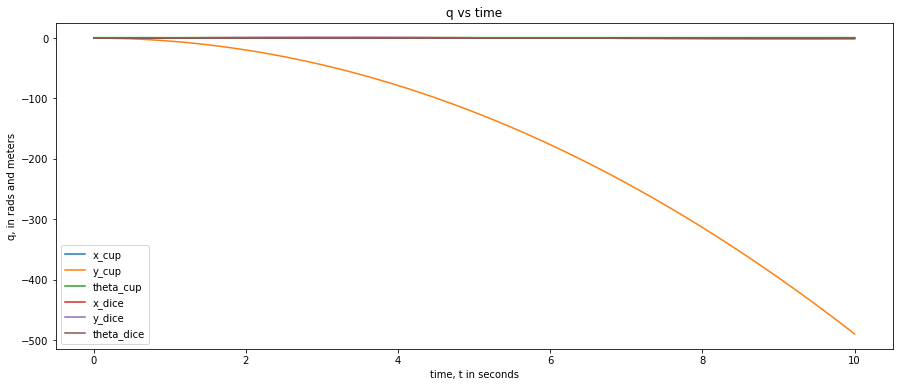

In [10]:
## Plotting simulation
import matplotlib.pyplot as plt


## Plotting the simulated system
def plot_traj(sim, tspan, dt):
    t_axis = np.linspace(min(tspan), max(tspan), (max(tspan)-min(tspan))/dt)
    fig, ax = plt.subplots(figsize=(15,6))
    ax.plot(t_axis, sim[0,:], label="x_cup")
    ax.plot(t_axis, sim[1,:], label="y_cup")
    ax.plot(t_axis, sim[2,:], label="theta_cup")
    ax.plot(t_axis, sim[3,:], label="x_dice")
    ax.plot(t_axis, sim[4,:], label="y_dice")
    ax.plot(t_axis, sim[5,:], label="theta_dice")
    ax.legend()
    ax.set_ylabel("q, in rads and meters")
    ax.set_xlabel("time, t in seconds")
    ax.set_title("q vs time")
    plt.show()
    
## Plotting non-impact system
plot_traj(sim, tSpan, dt)

In [11]:
## Animating
import numpy as np
def animate_dice_and_cup(s_array, L_c, L_d, T=10):
    """
    
    Function to generate web-based animation of bipedal split

    Parameters:
    ================================================
    s_array:
        trajectory of x, y, theta and first time derivatives of dice and cup should be a NumPy array with
        shape of (12, N)
    L_c:
        length and width of cup, assumed equal
    L_d:
        length and width of dice, assumed cube
    T:
        length/seconds of animation duration

    Returns: None
    """

    ################################
    # Imports required for animation.
    from plotly.offline import init_notebook_mode, iplot
    from IPython.display import display, HTML
    import plotly.graph_objects as go

    #######################
    # Browser configuration.
    def configure_plotly_browser_state():
        import IPython
        display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
            <script>
              requirejs.config({
                paths: {
                  base: '/static/base',
                  plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
                },
              });
            </script>
            '''))
    configure_plotly_browser_state()
    init_notebook_mode(connected=False)

    ###############################################
    ## Getting data from the split config array
    xxDice = s_array[0]
    yyDice = s_array[1]
    xxCup = s_array[3]
    yyCup = s_array[4]
    N = len(s_array[0])

    ###############################################
    # Define arrays containing data for frame axes, rectangle corners, and origins
    # In each frame, the x and y axis are always fixed
    x_axis = np.array([0.3, 0.0])
    y_axis = np.array([0.0, 0.3])
    
    ## Likewise, the rectangle corners are always fixed
    r1_dice = np.array([L_d/2, L_d/2])
    r2_dice = np.array([-L_d/2, L_d/2])
    r3_dice = np.array([-L_d/2, -L_d/2])
    r4_dice = np.array([L_d/2, -L_d/2])
    
    r1_cup = np.array([L_c/2, L_c/2])
    r2_cup = np.array([-L_c/2, L_c/2])
    r3_cup = np.array([-L_c/2, -L_c/2])
    r4_cup = np.array([L_c/2, -L_c/2])
    
    # Use homogeneous tranformation to transfer body vectors
    # back to the fixed frame
    
    frame_C_origin = np.zeros((2,N))
    frame_C_x_axis = np.zeros((2,N))   
    frame_C_y_axis = np.zeros((2,N))
    frame_C_r1 = np.zeros((2, N))
    frame_C_r2 = np.zeros((2, N))
    frame_C_r3 = np.zeros((2, N))
    frame_C_r4 = np.zeros((2, N))
    
    frame_D_origin = np.zeros((2,N))
    frame_D_x_axis = np.zeros((2,N))
    frame_D_y_axis = np.zeros((2,N))
    frame_D_r1 = np.zeros((2, N))
    frame_D_r2 = np.zeros((2, N))
    frame_D_r3 = np.zeros((2, N))
    frame_D_r4 = np.zeros((2, N))
    
    for i in range(N): 
        ## iteration through each time step
        ## evaluate homogeneous transformation
        
        t_ACup = np.array([[np.cos(s_array[5][i]), -np.sin(s_array[5][i]), 0, s_array[3][i]],
                           [np.sin(s_array[5][i]),  np.cos(s_array[5][i]), 0, s_array[4][i]],
                           [                    0,                     0,  1,             0],
                           [                    0,                     0,  0,             1]])
        
        t_ADice = np.array([[np.cos(s_array[2][i]), -np.sin(s_array[2][i]), 0, s_array[0][i]],
                            [np.sin(s_array[2][i]), np.cos(s_array[2][i]), 0,  s_array[1][i]],
                            [                    0,                     0,  1, 0],
                            [                    0,                     0,  0, 1]])
        
        frame_C_origin[:,i] = t_ACup.dot([0,0,0,1])[0:2]
        frame_C_x_axis[:,i] = t_ACup.dot([x_axis[0], x_axis[1], 0, 1 ])[0:2]
        frame_C_y_axis[:, i] = t_ACup.dot([y_axis[0], y_axis[1], 0, 1 ])[0:2]
        frame_C_r1[:, i] = t_ACup.dot([r1_cup[0], r1_cup[1], 0, 1])[0:2]
        frame_C_r2[:, i] = t_ACup.dot([r2_cup[0], r2_cup[1], 0, 1])[0:2]
        frame_C_r3[:, i] = t_ACup.dot([r3_cup[0], r3_cup[1], 0, 1])[0:2]
        frame_C_r4[:, i] = t_ACup.dot([r4_cup[0], r4_cup[1], 0, 1])[0:2]
        
        frame_D_origin[:,i] = t_ADice.dot([0,0,0,1])[0:2]
        frame_D_x_axis[:, i] = t_ADice.dot([x_axis[0], x_axis[1], 0, 1 ])[0:2]
        frame_D_y_axis[:, i] = t_ADice.dot([y_axis[0], y_axis[1], 0, 1 ])[0:2]
        frame_D_r1[:, i] = t_ADice.dot([r1_dice[0], r1_dice[1], 0, 1])[0:2]
        frame_D_r2[:, i] = t_ADice.dot([r2_dice[0], r2_dice[1], 0, 1])[0:2]
        frame_D_r3[:, i] = t_ADice.dot([r3_dice[0], r3_dice[1], 0, 1])[0:2]
        frame_D_r4[:, i] = t_ADice.dot([r4_dice[0], r4_dice[1], 0, 1])[0:2]
            

    ####################################
    # Using these to specify axis limits.
    xm = np.min(xxCup)-1.5 #-3
    xM = np.max(xxCup)+1.5 #3
    ym = np.min(yyCup)-1.5  #-3
    yM = np.max(yyCup)+1.5 #3

    ###########################
    # Defining data dictionary.
    # Trajectories are here.
    data=[
        # note that except for the trajectory (which you don't need this time),
        # you don't need to define entries other than "name". The items defined
        # in this list will be related to the items defined in the "frames" list
        # later in the same order. Therefore, these entries can be considered as 
        # labels for the components in each animation frame
        dict(name='Cup'),
        dict(name='Dice'), 
        dict(name='Cup Frame X Axis '),
        dict(name='Cup Frame Y Axis '),
        dict(name='Dice Frame X Axis '),
        dict(name='Dice Frame Y Axis '),
        ]

    ################################
    # Preparing simulation layout.
    # Title and axis ranges are here.
    layout=dict(autosize=False, width=1000, height=1000,
                xaxis=dict(range=[xm, xM], autorange=False, zeroline=False,dtick=1),
                yaxis=dict(range=[ym, yM], autorange=False, zeroline=False,scaleanchor = "x",dtick=1),
                title='Die in a Cup', 
                hovermode='closest',
                updatemenus= [{'type': 'buttons',
                               'buttons': [{'label': 'Play','method': 'animate',
                                            'args': [None, {'frame': {'duration': T, 'redraw': False}}]},
                                           {'args': [[None], {'frame': {'duration': T, 'redraw': False}, 'mode': 'immediate',
                                            'transition': {'duration': 0}}],'label': 'Pause','method': 'animate'}
                                          ]
                              }]
               )

    ########################################
    # Defining the frames of the simulation.
    # This is what draws the lines from
    # joint to joint of the pendulum.
    frames=[dict(data=[## display x and y axes of the fixed world frame in each animation frame
        
                       ## display cup and dice in each animation frame
                       dict(x=[frame_C_r1[0][k], frame_C_r2[0][k], frame_C_r3[0][k], frame_C_r4[0][k], frame_C_r1[0][k]], 
                            y=[frame_C_r1[1][k], frame_C_r2[1][k], frame_C_r3[1][k], frame_C_r4[1][k], frame_C_r1[1][k]],
                            mode='lines',
                            line=dict(color='purple', width=3),
                            ),
                       dict(x=[frame_D_r1[0][k], frame_D_r2[0][k], frame_D_r3[0][k], frame_D_r4[0][k], frame_D_r1[0][k]], 
                            y=[frame_D_r1[1][k], frame_D_r2[1][k], frame_D_r3[1][k], frame_D_r4[1][k], frame_D_r1[1][k]],
                            mode='lines',
                            line=dict(color='orange', width=3),
                            ),
                       dict(x=[frame_C_origin[0][k],frame_C_x_axis[0][k]], 
                            y=[frame_C_origin[1][k],frame_C_x_axis[1][k]], 
                            mode='lines',
                            line=dict(color='purple', width=1),
                            ),
                       dict(x=[frame_C_origin[0][k],frame_C_y_axis[0][k]], 
                            y=[frame_C_origin[1][k],frame_C_y_axis[1][k]], 
                            mode='lines',
                            line=dict(color='purple', width=1),
                            ),
                       dict(x=[frame_D_origin[0][k],frame_D_x_axis[0][k]], 
                            y=[frame_D_origin[1][k],frame_D_x_axis[1][k]], 
                            mode='lines',
                            line=dict(color='orange', width=1),
                            ),
                       dict(x=[frame_D_origin[0][k],frame_D_y_axis[0][k]], 
                            y=[frame_D_origin[1][k],frame_D_y_axis[1][k]], 
                            mode='lines',
                            line=dict(color='orange', width=1),
                            ),
                    

                      ]) for k in range(N)]

    #######################################
    # Putting it all together and plotting.
    figure1=dict(data=data, layout=layout, frames=frames)           
    iplot(figure1)
    

## Animating system ignoring impacts
animate_dice_and_cup(sim, L_c=4, L_d=0.5)

In [12]:
## Updating simulate function for impact considerations
def check_for_impact(s, threshold = 5e-2):
    impact_types = []
    for i in range(len(impact_test_functions)):
        if -threshold < impact_test_functions[i](*s[:6]) < threshold:
            impact_types.append(i)
            break
    return len(impact_types) > 0, impact_types

def simulate_with_impacts(f, x0, tspan, dt, integrate, impact_check, impact_update): 
    N = int((max(tspan)-min(tspan))/dt)
    x = np.copy(x0)
    tvec = np.linspace(min(tspan),max(tspan),N)
    xtraj = np.zeros((len(x0),N))
    for i in range(N):
        xtraj[:,i]=integrate(f,x,tvec[i],dt)
        impact, constraint_idx = impact_check(xtraj[:, i])
        if impact:
            xtraj[:, i] = impact_update(constraint_idx[0], xtraj[:, i-1])
        x = np.copy(xtraj[:,i])
    return xtraj 

## Simulating with impact updates
sim_wImp = simulate_with_impacts(dyn_sys, s0, tSpan, dt, integrate, check_for_impact, impact_update)
print(sim_wImp.shape)

(12, 2000)


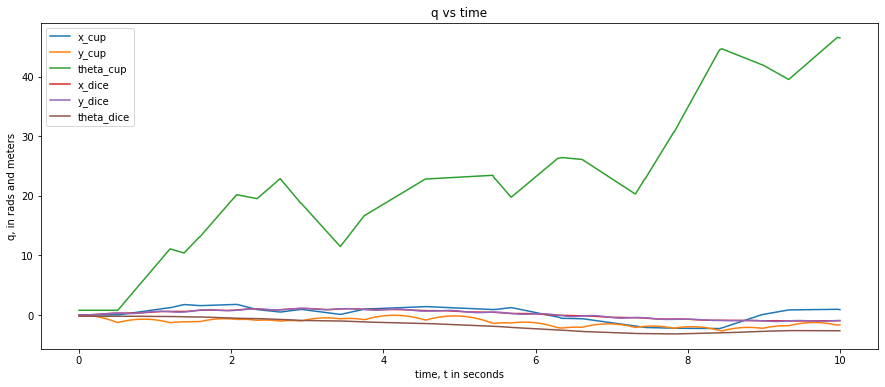

In [13]:
## Plotting trajectory with impacts

plot_traj(sim_wImp, tSpan, dt)

In [14]:
## Animating trajectory with impacts
animate_dice_and_cup(sim_wImp, L_c=4, L_d=0.5)